<a href="https://colab.research.google.com/github/srimanthtenneti/MakeUC_Submission/blob/main/COVID_Tweets_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Sentiment Density Determination 

This project mainly focuses on analysing the tweets and extracting sentiment from them.

## Problems

 Some of the  major problems we have with the dataset are :

 * The data is not annotated. 
 * The data is distributed across multiple columns and we need to combine the relavent information to have a good model. 

## Solutions

* As the data is not annotated the first major task is to use unsepervised learning models to determine the annotations. Then we can later apply the regular models to predict the sentiment. 

* Also, as data is distributed across multiple columns we need to formulate a predictive theory to come up with a way of combining relavent information to create an efficient predictive model. 


### Installing Libraries

In [8]:
!pip install folium
!pip install geopy
!pip install wordcloud
!pip install xlrd

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


### Importing Libraries

In [9]:
import os
import pandas as pd # Loading the CSV file
import numpy as np # Numeric python library 
import matplotlib.pyplot as plt # Visualization

import folium # Maps
from sklearn.model_selection import train_test_split # Splitting the data

### Loading the data

In [10]:
# The data in some reason was not in a proper format so had to convert it to excel and then process it
data = pd.read_excel("/content/allcovidvaccinationtweets.xlsx") 
data.head() # Viewing the top of the dataset

,id,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,retweets,favorites,is_retweet
0,1.340540e+18,Rachel Roh,"La Crescenta-Montrose, CA",Aggregator of Asian American news; scanning di...,2009-04-08 17:52:00,405,1692,3247,False,2020-12-20 06:06:00,Same folks said daikon paste could treat a cyt...,['PfizerBioNTech'],Twitter for Android,0,0,False
1,1.338160e+18,Albert Fong,"San Francisco, CA","Marketing dude, tech geek, heavy metal & '80s ...",2009-09-21 15:27:00,834,666,178,False,2020-12-13 16:27:00,While the world has been on the wrong side of ...,NaN,Twitter Web App,1,1,False
2,1.337860e+18,eli_Ùà±_Ùà__Ùà»_Ùà¼_ÙÔÎ,Your Bed,"heil, hydra _ÙÐ‰÷¼",2020-06-25 23:30:00,10,88,155,False,2020-12-12 20:33:00,#coronavirus #SputnikV #AstraZeneca #PfizerBio...,"['coronavirus', 'SputnikV', 'AstraZeneca', 'Pf...",Twitter for Android,0,0,False
3,1.337860e+18,Charles Adler,"Vancouver, BC - Canada","Hosting ""CharlesAdlerTonight"" Global News Radi...",2008-09-10 11:28:00,49165,3933,21853,True,2020-12-12 20:23:00,"Facts are immutable, Senator, even when you're...",NaN,Twitter Web App,446,2129,False
4,1.337850e+18,Citizen News Channel,NaN,Citizen News Channel bringing you an alternati...,2020-04-23 17:58:00,152,580,1473,False,2020-12-12 20:17:00,Explain to me again why we need a vaccine @Bor...,"['whereareallthesickpeople', 'PfizerBioNTech']",Twitter for iPhone,0,0,False


* Looking at the dataset we can clearly see that it is not clean and there are a lot of issues in it. Some of them are: 
  
    1)  Improper names

    2) Missing or improper locations

* So, the simplest thing to do now would be to drop all the missing data first. 

### Looking at Missing entries

In [11]:
data.isna() # Clearly we can see thay a lot of the user_location data is missing 
# For the project sentiment density determination this is the most important parameter. 

,id,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,retweets,favorites,is_retweet
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False
4,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36995,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
36996,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False
36997,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False
36998,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False


### Eleminating Missing Entries

In [12]:
dataset = data.dropna() # Dropping all the NaN

### Reseting the index 

In [13]:
dataset = dataset.reset_index()
dataset.tail() # Dataset with no missing data (no NaN)

,index,id,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,retweets,favorites,is_retweet
21562,36988,1.371740e+18,C'axent Lucien A.M. Borkes,Dutch speaking Belgium,"C'axent Flanders-Belgium, EU, world: for more ...",2020-09-20 08:00:00,24,196,855,False,2021-03-16 08:16:00,The head of #Russia 's RDIF sovereign wealth f...,"['Russia', 'Italy']",Twitter Web App,1,0,False
21563,36989,1.371730e+18,Dmitry‰ªä•üBalykoff,Ethiopia,In rainbow _ÙÎö we trust...,2010-11-18 15:32:00,102,40,6676,False,2021-03-16 07:52:00,@OurParliamentUk @JeremyClarkson Don‰Ûªt worry...,['SputnikV'],Twitter for iPhone,0,0,False
21564,36992,1.371720e+18,ELEKTRIKA.SK,Slovakia,#tips #hints in #electrical #greenEnergy #LEDl...,2013-01-03 14:02:00,41,177,1172,False,2021-03-16 07:22:00,#15Mar| ‰ÛÏUnexpected bet: Europe negotiates #...,"['15Mar', 'SputnikV', 'trading', 'investing']",Twitter for iPhone,0,0,False
21565,36993,1.371720e+18,Ahmad Ismail,France,Research Consultant: Political-Economy Analysi...,2014-05-31 12:05:00,276,1217,1363,False,2021-03-16 07:15:00,Dr Reddy‰Ûªs completes #Russia's Sputnik vacci...,"['Russia', 'India']",Twitter for Android,7,15,False
21566,36995,1.371720e+18,Sukhoi Su-57 Felon _Ùàá_Ùà¼_Ùà¨_Ùà_,India,i am a Defence analyst of DFI.. News i post or...,2018-06-30 17:52:00,17169,320,92360,False,2021-03-16 07:14:00,The EU intends to start negotiations on the pu...,"['Russian', 'SputnikV']",Twitter Web App,2,9,False


### Visualizing the data distribution

#### User followers

Text(0, 0.5, 'Counts')

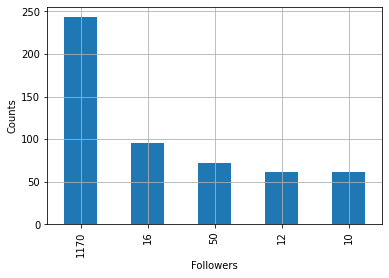

In [14]:
dataset.user_followers.value_counts().head().plot.bar()
plt.grid('True')
plt.xlabel('Followers')
plt.ylabel('Counts')

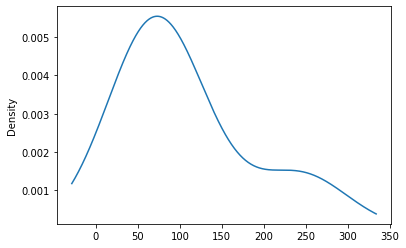

In [15]:
dataset.user_followers.value_counts().head().plot.kde()

#### Retweets

Text(0, 0.5, 'Counts')

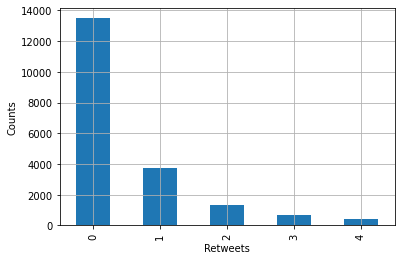

In [16]:
dataset.retweets.value_counts().head().plot.bar()
plt.grid('True')
plt.xlabel('Retweets')
plt.ylabel('Counts')

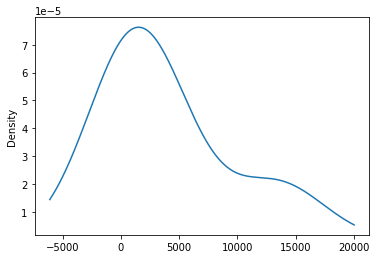

In [17]:
dataset.retweets.value_counts().head().plot.kde()

#### User favourites

Text(0, 0.5, 'Counts')

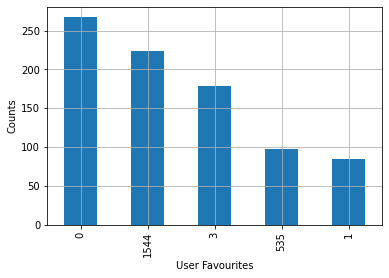

In [18]:
dataset.user_favourites.value_counts().head().plot.bar()
plt.grid('True')
plt.xlabel('User Favourites')
plt.ylabel('Counts')

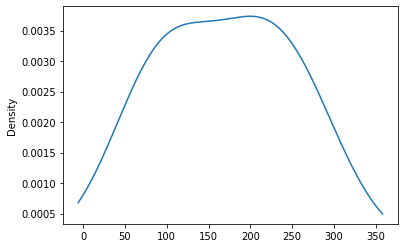

In [19]:
dataset.user_favourites.value_counts().head().plot.kde()

#### User Friends

Text(0, 0.5, 'Counts')

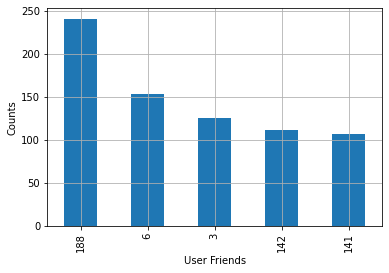

In [20]:
dataset.user_friends.value_counts().head().plot.bar()
plt.grid('True')
plt.xlabel('User Friends')
plt.ylabel('Counts')

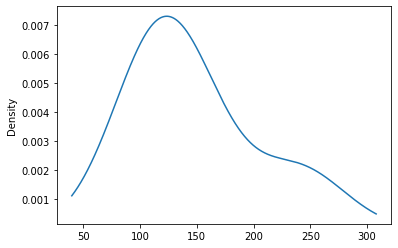

In [21]:
dataset.user_friends.value_counts().head().plot.kde()

#### Sources

Text(0, 0.5, 'Counts')

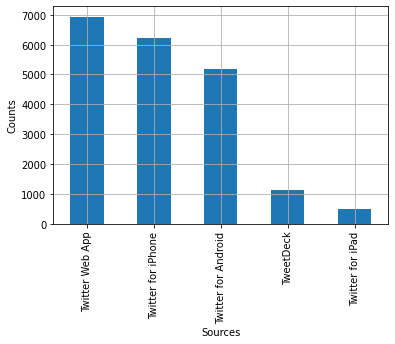

In [22]:
dataset.source.value_counts().head().plot.bar()
plt.grid('True')
plt.xlabel('Sources')
plt.ylabel('Counts')

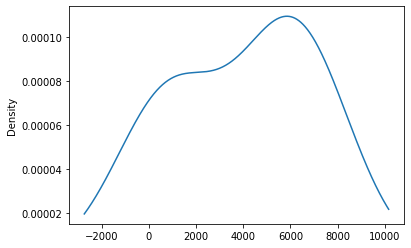

In [23]:
dataset.source.value_counts().head().plot.kde()

#### Initial Analysis

#### Looking at Verified users

In [24]:
dataset[dataset['user_verified'] == 'True'].head()
dataset.reset_index(0 , len(dataset))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: In a future version of pandas all arguments of DataFrame.reset_index except for the argument 'level' will be keyword-only
  


,index,id,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,retweets,favorites,is_retweet
0,0,1.340540e+18,Rachel Roh,"La Crescenta-Montrose, CA",Aggregator of Asian American news; scanning di...,2009-04-08 17:52:00,405,1692,3247,False,2020-12-20 06:06:00,Same folks said daikon paste could treat a cyt...,['PfizerBioNTech'],Twitter for Android,0,0,False
1,2,1.337860e+18,eli_Ùà±_Ùà__Ùà»_Ùà¼_ÙÔÎ,Your Bed,"heil, hydra _ÙÐ‰÷¼",2020-06-25 23:30:00,10,88,155,False,2020-12-12 20:33:00,#coronavirus #SputnikV #AstraZeneca #PfizerBio...,"['coronavirus', 'SputnikV', 'AstraZeneca', 'Pf...",Twitter for Android,0,0,False
2,6,1.337850e+18,Gunther Fehlinger,"Austria, Ukraine and Kosovo",End North Stream 2 now - the pipeline of corru...,2013-06-10 17:49:00,2731,5001,69344,False,2020-12-12 20:06:00,it is a bit sad to claim the fame for success ...,['vaccination'],Twitter Web App,0,4,False
3,9,1.337840e+18,Ch.Amjad Ali,Islamabad,#ProudPakistani #LovePakArmy #PMIK @insafiansp...,2012-11-12 04:18:00,671,2368,20469,False,2020-12-12 19:30:00,#CovidVaccine _x000D__x000D_States will start ...,"['CovidVaccine', 'COVID19Vaccine', 'US', 'paku...",Twitter Web App,0,0,False
4,10,1.337840e+18,Tamer Yazar,Turkey-Israel,"Im Market Analyst, also Editor... working (fre...",2009-09-17 16:45:00,1302,78,339,False,2020-12-12 19:29:00,"while deaths are closing in on the 300,000 mar...","['PfizerBioNTech', 'Vaccine']",Twitter Web App,0,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21562,36988,1.371740e+18,C'axent Lucien A.M. Borkes,Dutch speaking Belgium,"C'axent Flanders-Belgium, EU, world: for more ...",2020-09-20 08:00:00,24,196,855,False,2021-03-16 08:16:00,The head of #Russia 's RDIF sovereign wealth f...,"['Russia', 'Italy']",Twitter Web App,1,0,False
21563,36989,1.371730e+18,Dmitry‰ªä•üBalykoff,Ethiopia,In rainbow _ÙÎö we trust...,2010-11-18 15:32:00,102,40,6676,False,2021-03-16 07:52:00,@OurParliamentUk @JeremyClarkson Don‰Ûªt worry...,['SputnikV'],Twitter for iPhone,0,0,False
21564,36992,1.371720e+18,ELEKTRIKA.SK,Slovakia,#tips #hints in #electrical #greenEnergy #LEDl...,2013-01-03 14:02:00,41,177,1172,False,2021-03-16 07:22:00,#15Mar| ‰ÛÏUnexpected bet: Europe negotiates #...,"['15Mar', 'SputnikV', 'trading', 'investing']",Twitter for iPhone,0,0,False
21565,36993,1.371720e+18,Ahmad Ismail,France,Research Consultant: Political-Economy Analysi...,2014-05-31 12:05:00,276,1217,1363,False,2021-03-16 07:15:00,Dr Reddy‰Ûªs completes #Russia's Sputnik vacci...,"['Russia', 'India']",Twitter for Android,7,15,False


### Looking at tweets of popular people

* This is a list of people who are most likely influencers as they have a lot of followers. 

* Also, as they are infuential people they may possibly have an impact on the sentiment in that location.

In [25]:
dataset[dataset.user_followers > 10000].head()

,index,id,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,retweets,favorites,is_retweet
5,15,1.337790e+18,City A.M.,"London, England","London's business newspaper - News, Opinion, a...",2009-06-09 13:53:00,66224,603,771,True,2020-12-12 16:00:00,Trump announces #vaccine rollout 'in less than...,['vaccine'],Twitter for iPhone,0,1,False
11,22,1.337770e+18,City A.M.,"London, England","London's business newspaper - News, Opinion, a...",2009-06-09 13:53:00,66224,603,771,True,2020-12-12 14:59:00,Trump announces #vaccine rollout 'in less than...,['vaccine'],Buffer,1,0,False
20,35,1.337740e+18,Shahjhan Malik | #WearAMask,"Nottinghamshire, England",Solicitor.Dual Qualified.Single Parent Of 2 Am...,2017-06-22 06:22:00,41708,2868,47862,False,2020-12-12 12:42:00,An immigrant Muslim couple find the COVID-19 V...,"['CovidVaccine', 'PfizerBioNTech', 'Pfizervacc...",Twitter for iPhone,2,37,False
25,43,1.337730e+18,City A.M.,"London, England","London's business newspaper - News, Opinion, a...",2009-06-09 13:53:00,66224,603,771,True,2020-12-12 11:59:00,Trump announces #vaccine rollout 'in less than...,['vaccine'],Twitter Web App,0,2,False
26,44,1.337730e+18,Daily News Egypt,Egypt,Egypt's Only Daily Independent Newspaper in En...,2009-04-26 07:56:00,278080,116,765,True,2020-12-12 11:55:00,#FDA authorizes #PfizerBioNTech #coronavirus v...,"['FDA', 'PfizerBioNTech', 'coronavirus']",Twitter Web App,1,1,False


In [26]:
dataset.sort_values(by = ['date' , 'favorites'] , ascending= [True , False]).head(n=5)

,index,id,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,retweets,favorites,is_retweet
26,44,1.337730e+18,Daily News Egypt,Egypt,Egypt's Only Daily Independent Newspaper in En...,2009-04-26 07:56:00,278080,116,765,True,2020-12-12 11:55:00,#FDA authorizes #PfizerBioNTech #coronavirus v...,"['FDA', 'PfizerBioNTech', 'coronavirus']",Twitter Web App,1,1,False
25,43,1.337730e+18,City A.M.,"London, England","London's business newspaper - News, Opinion, a...",2009-06-09 13:53:00,66224,603,771,True,2020-12-12 11:59:00,Trump announces #vaccine rollout 'in less than...,['vaccine'],Twitter Web App,0,2,False
23,40,1.337730e+18,"Party politics isn't working for anyone, anywhere","Wales, United Kingdom",No lie to another is respectful; no lie to you...,2016-08-03 20:11:00,761,504,33675,False,2020-12-12 12:16:00,@mirekR9 @sputnikvaccine @AstraZeneca it's the...,['PfizerBioNTech'],Twitter Web App,0,0,False
24,41,1.337730e+18,KHuntson,USA_Ùà¼_Ùàü,"RN, health educator, writer, researcher, wife,...",2014-01-31 01:25:00,2035,1672,6734,False,2020-12-12 12:16:00,FACT SHEET FOR RECIPIENTS AND CAREGIVERS_x000D...,"['PfizerBioNTech', 'CovidVaccine']",Twitter Web App,0,0,False
22,38,1.337730e+18,KHuntson,USA_Ùà¼_Ùàü,"RN, health educator, writer, researcher, wife,...",2014-01-31 01:25:00,2035,1672,6734,False,2020-12-12 12:19:00,FACT SHEET FOR HEALTHCARE PROVIDERS ADMINISTER...,"['PfizerBioNTech', 'CovidVaccine']",Twitter Web App,0,0,False


### Raw Theory 

* Understanding the sentiment we only need the text as our model is unsupervised. 

* But to determine the density we would have to filter out valid location data.  

* To get understand the sentiment variation of a particular user we would have to see if the user has multiple tweets, then we would have to determine the sentiment of those tweets and see if there is any change. 

* Here by looking at the above example we are not able to see enough polarity even in some strong words to use this as a feature to annotate the data. 

* So, first we would clean the data by removing all the URLs and other irrelavent information and then sum up all the word scores of the words in the sentence. If we are still not able to see clear difference we might have to apply certain transformations to get a clear distinction. 

* We need 3 clusters to incorporate positive , negative and neutral sentiments.

### Implementing the URL filter

In [27]:
import re # Function to remove all the URLs
def remove_urls (vTEXT):
    vTEXT = vTEXT.replace('‰Û', ' ')
    vTEXT = vTEXT.replace('‰Û_', ' ')
    vTEXT = vTEXT.replace('#', ' ')
    vTEXT = re.sub(r'(‰Û_|https|http)?:\/\/(\w|\.|\/|\?|\=|\&|\%)*\b', '', vTEXT, flags=re.MULTILINE)
    vTEXT = re.sub(r'(‰Û_ )*\b', '', vTEXT, flags=re.MULTILINE)
    return (vTEXT)

In [28]:
data['text'][0] # Before

'Same folks said daikon paste could treat a cytokine storm #PfizerBioNTech https://t.co/xeHhIMg1kF'

In [29]:
remove_urls(data['text'][0]) # No URLs in the data {After}

'Same folks said daikon paste could treat a cytokine storm  PfizerBioNTech '

In [30]:
# Modifying the dataset.text

text_data = []
for text in dataset.text:
  text_data.append(remove_urls(text))
dataset['text'] = text_data

### Updating the Text data

In [31]:
dataset.head() # Now we cleaned the text of all the URLs

,index,id,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,retweets,favorites,is_retweet
0,0,1.340540e+18,Rachel Roh,"La Crescenta-Montrose, CA",Aggregator of Asian American news; scanning di...,2009-04-08 17:52:00,405,1692,3247,False,2020-12-20 06:06:00,Same folks said daikon paste could treat a cyt...,['PfizerBioNTech'],Twitter for Android,0,0,False
1,2,1.337860e+18,eli_Ùà±_Ùà__Ùà»_Ùà¼_ÙÔÎ,Your Bed,"heil, hydra _ÙÐ‰÷¼",2020-06-25 23:30:00,10,88,155,False,2020-12-12 20:33:00,coronavirus SputnikV AstraZeneca PfizerBio...,"['coronavirus', 'SputnikV', 'AstraZeneca', 'Pf...",Twitter for Android,0,0,False
2,6,1.337850e+18,Gunther Fehlinger,"Austria, Ukraine and Kosovo",End North Stream 2 now - the pipeline of corru...,2013-06-10 17:49:00,2731,5001,69344,False,2020-12-12 20:06:00,it is a bit sad to claim the fame for success ...,['vaccination'],Twitter Web App,0,4,False
3,9,1.337840e+18,Ch.Amjad Ali,Islamabad,#ProudPakistani #LovePakArmy #PMIK @insafiansp...,2012-11-12 04:18:00,671,2368,20469,False,2020-12-12 19:30:00,CovidVaccine _x000D__x000D_States will start ...,"['CovidVaccine', 'COVID19Vaccine', 'US', 'paku...",Twitter Web App,0,0,False
4,10,1.337840e+18,Tamer Yazar,Turkey-Israel,"Im Market Analyst, also Editor... working (fre...",2009-09-17 16:45:00,1302,78,339,False,2020-12-12 19:29:00,"while deaths are closing in on the 300,000 mar...","['PfizerBioNTech', 'Vaccine']",Twitter Web App,0,0,False


### Looking at the Column info

In [32]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21567 entries, 0 to 21566
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   index             21567 non-null  int64         
 1   id                21567 non-null  float64       
 2   user_name         21567 non-null  object        
 3   user_location     21567 non-null  object        
 4   user_description  21567 non-null  object        
 5   user_created      21567 non-null  datetime64[ns]
 6   user_followers    21567 non-null  int64         
 7   user_friends      21567 non-null  int64         
 8   user_favourites   21567 non-null  int64         
 9   user_verified     21567 non-null  bool          
 10  date              21567 non-null  datetime64[ns]
 11  text              21567 non-null  object        
 12  hashtags          21567 non-null  object        
 13  source            21567 non-null  object        
 14  retweets          2156

In [33]:
dataset.describe()

,index,id,user_followers,user_friends,user_favourites,retweets,favorites
count,21567.000000,2.156700e+04,2.156700e+04,21567.000000,21567.000000,21567.000000,21567.000000
mean,18550.283303,1.364683e+18,1.601813e+05,1533.071498,15382.887699,3.951639,17.666759
std,10662.251814,8.530700e+15,1.109492e+06,7137.975112,39255.634932,42.863465,228.463927
min,0.000000,1.337730e+18,0.000000e+00,0.000000,0.000000,0.000000,0.000000
25%,9337.000000,1.361690e+18,2.190000e+02,180.000000,486.000000,0.000000,0.000000
50%,18612.000000,1.366640e+18,9.430000e+02,504.000000,2609.000000,0.000000,1.000000
75%,27814.000000,1.370935e+18,4.021000e+03,1396.000000,12423.500000,1.000000,4.000000
max,36995.000000,1.374650e+18,1.490097e+07,380428.000000,849797.000000,2360.000000,22815.000000


### Transforming the data

In [34]:
# Transforming the text
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(stop_words={'english'})
X = vectorizer.fit_transform(dataset['text'])

### Finding the optimal number of clusters 

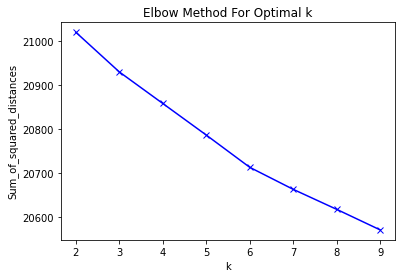

In [35]:
# Looking at the optimal clusters number

import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
Sum_of_squared_distances = []
K = range(2,10)
for k in K:
   km = KMeans(n_clusters=k, max_iter=200, n_init=10)
   km = km.fit(X)
   Sum_of_squared_distances.append(km.inertia_)
plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

### Implementing the KMeans model

In [36]:
# KMeans CLustering

from sklearn.cluster import KMeans

# We are taking 3 clusters to incorporate postive , negative and neutral tweets
model = KMeans(n_clusters = 3 , random_state = 23)

x_topics = model.fit(X)


In [37]:
preds = []
for w in X:
  preds.append(x_topics.predict(w))

In [38]:
text = dataset['text']
text = text.reset_index(0 , len(dataset))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: FutureWarning: In a future version of pandas all arguments of Series.reset_index except for the argument 'level' will be keyword-only
  


In [39]:
#Viewing the output

for i in range(len(text[:100])):
  print(text[i] + ":" + str (preds[i]))

Same folks said daikon paste could treat a cytokine storm  PfizerBioNTech :[1]
 coronavirus  SputnikV  AstraZeneca  PfizerBioNTech  Moderna  Covid_19 Russian vaccine is created to last 2-4 years  :[1]
it is a bit sad to claim the fame for success of  vaccination on patriotic competition between USA, Canada, UK and  :[1]
 CovidVaccine _x000D__x000D_States will start getting  COVID19Vaccine Monday,  US says _x000D_ pakustv  NYC  Healthcare  GlobalGoals  :[1]
while deaths are closing in on the 300,000 mark... millions of people wait  PfizerBioNTech  Vaccine !_x000D_-_x000D_The first U  :[1]
Trump announces  vaccine rollout 'in less than 24 hours'_x000D__x000D_The first Americans will be vaccinated against  :[1]
UPDATED:  YellowFever &amp;  COVID19  ImmunityPassports - Part Two_x000D__x000D_ SARSCoV2  PfizerBioNtech  Britain  December  :[1]
Coronavirus: Iran reports 8,201 new cases, 221 deaths in the last 24 hours  Iran  coronavirus  PfizerBioNTech  :[1]
.@Pfizer will rake in billions from

In [40]:
dataset["labels"] = preds

In [60]:
dataset['text'][dataset["labels"] == 2].tail(n = 10) # Pos

20691    Got my  covaxin jab yesterday .. absolutely no...
20693    Got my  covaxin jab yesterday .. absolutely no...
20719    I got my first dose... _ÙÕä_x000D_Done ‰ÏÉ _x0...
20817     Putin got  vaccinated  today against  Covid19...
20860    My 72-year old granny got vaccinated with  Spu...
21033    Looking forward to getting my dose of V4  COVI...
21166    Traveled to St.Petersburg, Russia and got my 1...
21203    Post garde, heading to have my first shot of t...
21338    @AnatomyRoyer I've got my second dose  CovidVa...
21347    Just got me  SputnikV  Covid  vaccine feeling ...
Name: text, dtype: object

In [61]:
dataset['text'][dataset["labels"] == 1].tail(n = 10) # Neu

21557    Swedish companies in talks with  RDIF on produ...
21558    Gland Pharma has entered into an agreement to ...
21559    Gland Pharma has entered into an agreement to ...
21560    Russia donates  SputnikV  vaccine doses to  Vi...
21561     Breaking _x000D_Sources:  SputnikV phase 3 tr...
21562    The head of  Russia 's RDIF sovereign wealth f...
21563    @OurParliamentUk @JeremyClarkson Don‰Ûªt worry...
21564     15Mar| ‰ÛÏUnexpected bet: Europe negotiates  ...
21565    Dr Reddy‰Ûªs completes  Russia's Sputnik vacci...
21566    The EU intends to start negotiations on the pu...
Name: text, dtype: object

In [62]:
dataset['text'][dataset["labels"] == 0].tail(n = 10) # Neg

21471    @CP24 Moscow Russia everything is open busines...
21490    Moscow Russia everything is open business as u...
21504    @CBCNews Moscow Russia everything is open busi...
21510    @CPHO_Canada Embarrassing Ontario is reporting...
21517    @JohnTory @Thompson_37 @TorontoPFR Embarrassin...
21518    Moscow Russia everything is open business as u...
21520    @CPHO_Canada Embarrassing Ontario is reporting...
21521    @celliottability Embarrassing Ontario is repor...
21522    Embarrassing Ontario is reporting 1074 cases o...
21538    India could soon get another  Covid19vaccine, ...
Name: text, dtype: object

In [54]:
print("Total Positives : ", len(dataset[dataset["labels"] == 2]))

Total Positives :  3282


In [55]:
print("Total Neutral : ", len(dataset[dataset["labels"] == 1]))

Total Neutral :  14964


In [56]:
print("Total Negatie : ", len(dataset[dataset["labels"] == 0]))

Total Negatie :  3321


In [47]:
dataset.head()

,index,id,user_name,user_location,user_description,user_created,user_followers,user_friends,user_favourites,user_verified,date,text,hashtags,source,retweets,favorites,is_retweet,labels
0,0,1.340540e+18,Rachel Roh,"La Crescenta-Montrose, CA",Aggregator of Asian American news; scanning di...,2009-04-08 17:52:00,405,1692,3247,False,2020-12-20 06:06:00,Same folks said daikon paste could treat a cyt...,['PfizerBioNTech'],Twitter for Android,0,0,False,[1]
1,2,1.337860e+18,eli_Ùà±_Ùà__Ùà»_Ùà¼_ÙÔÎ,Your Bed,"heil, hydra _ÙÐ‰÷¼",2020-06-25 23:30:00,10,88,155,False,2020-12-12 20:33:00,coronavirus SputnikV AstraZeneca PfizerBio...,"['coronavirus', 'SputnikV', 'AstraZeneca', 'Pf...",Twitter for Android,0,0,False,[1]
2,6,1.337850e+18,Gunther Fehlinger,"Austria, Ukraine and Kosovo",End North Stream 2 now - the pipeline of corru...,2013-06-10 17:49:00,2731,5001,69344,False,2020-12-12 20:06:00,it is a bit sad to claim the fame for success ...,['vaccination'],Twitter Web App,0,4,False,[1]
3,9,1.337840e+18,Ch.Amjad Ali,Islamabad,#ProudPakistani #LovePakArmy #PMIK @insafiansp...,2012-11-12 04:18:00,671,2368,20469,False,2020-12-12 19:30:00,CovidVaccine _x000D__x000D_States will start ...,"['CovidVaccine', 'COVID19Vaccine', 'US', 'paku...",Twitter Web App,0,0,False,[1]
4,10,1.337840e+18,Tamer Yazar,Turkey-Israel,"Im Market Analyst, also Editor... working (fre...",2009-09-17 16:45:00,1302,78,339,False,2020-12-12 19:29:00,"while deaths are closing in on the 300,000 mar...","['PfizerBioNTech', 'Vaccine']",Twitter Web App,0,0,False,[1]


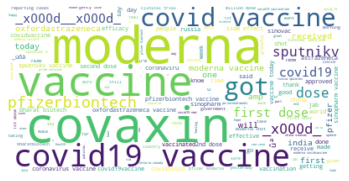

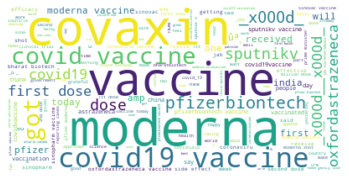

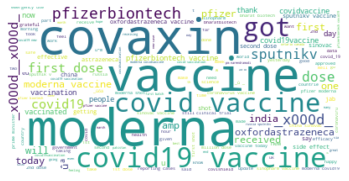

In [48]:
# Word Cloud Generation

from wordcloud import WordCloud
result={'cluster':preds,'Tweets': text}
result=pd.DataFrame(result)
for k in range(0,3):
   s=result[result.cluster==k]
   text=dataset['text'].str.cat(sep=' ')
   text=text.lower()
   text=' '.join([word for word in text.split()])
   wordcloud = WordCloud(max_font_size=60, max_words=800, background_color="white").generate(text)
   titles= dataset['labels']
   plt.figure()
   plt.imshow(wordcloud, interpolation="bilinear")
   plt.axis("off")
   plt.show()


In [64]:
# Sentiment density 
import geopy

In [65]:
location = dataset.user_location
location = location.dropna()
location = location.reset_index(0 , len(location))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: In a future version of pandas all arguments of Series.reset_index except for the argument 'level' will be keyword-only
  This is separate from the ipykernel package so we can avoid doing imports until


In [66]:
geolocator = geopy.Nominatim(user_agent="COVID-19")

In [67]:
geolocator.geocode(location[5])

Location(London, Greater London, England, United Kingdom, (51.5073219, -0.1276474, 0.0))

### Note: 

* The geolocation service is very slow and it took roughly about 2 hrs to decode 8464 datapoints. 

* So, it would roughly take 6 hrs to decode all the data points. 

* For the poc we have used the 8k locations to create the map

In [76]:
# Had to stop as it was taking too long.

from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="locamapper")
geopy.geocoders.options.default_timeout = 1000
latlong = []
noloc = []
for i in range(len(location)):
  loc = geolocator.geocode(location[i])
  if loc is not None:
      latlong.append((loc.latitude , loc.longitude))
  else:
    noloc.append(i)


In [77]:
len(latlong)

18014

In [78]:
# Saving the data

d = pd.DataFrame(data = latlong)
d = d.reset_index(0 , len(latlong))
d.to_csv("location.csv")
dataset.to_csv("finalannotateddataset.csv")

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.reset_index except for the argument 'level' will be keyword-only
  after removing the cwd from sys.path.


In [79]:
# Creating the folium map

m = folium.Map()

pred = dataset['labels'][:len(latlong)]
pred = pred.reset_index(0 , len(pred))

for i in range(len(latlong)):

  if pred[i] == 2:
          color="green"
          tooltip = 'Positive'
  if pred[i] == 0:
          color="crimson"
          tooltip = 'Negative'
  if pred[i] == 1:
          color="yellow"
          tooltip = 'Neutral'

  folium.Circle(
      radius=100,
      location=(d[0][i] , d[1][i]),
      color=color,
      tooltip = tooltip
  ).add_to(m)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: FutureWarning: In a future version of pandas all arguments of Series.reset_index except for the argument 'level' will be keyword-only
  


In [80]:
m # To see the negative points we need to decode more locations